# Summary
This file is a quick walkthrough of the utils3d library created for the processing of 3-dimensional data, particularly that which is found in a .las file. You can get a .las file from a set of photos by using one of the tutorials at the following website: https://photos.app.goo.gl/AvLQqtJPrbbYxAPPA. You will need either Pix4DMapper, which has shown substantially better results in testing, or Agisoft's Metashape Pro.

Pix4D has a trove of resources here: https://support.pix4d.com/hc/en-us/categories/360001503192-Pix4Dmapper. The Metashape Pro guide is here: https://www.agisoft.com/pdf/metashape-pro_1_5_en.pdf. Chapter 3 is where the most useful content is for creating a dense point cloud.

The rule of thumb for both of these softwares - the default options are there for a reason and are pretty effective.


### Overview
* Load Data
* Visualize 3D Data with Matplotlib
* Remove background by z-axis thresholding
* Remove background by color
* Touch up final background extractions
* Get the geodesic distance of all points from one central point
* Make a heat map of the z-axis by blocks

In [24]:
import utils3d as u3d
import matplotlib.pyplot as plt
import numpy as np

# Load the data from the specified path
And extract the x,y,z coords and color values from the file struct


In [25]:
# fname = "./07-29_3dplant2subtractedfiles_group1_densified_point_cloud.las"
fname = "./test_data.las"
inFile = u3d.loadLASData(fname)
colors, dataset = u3d.extractXYZColors(inFile)

Attributes of the las file:
X
Y
Z
intensity
flag_byte
raw_classification
scan_angle_rank
user_data
pt_src_id
gps_time
red
green
blue


Downsample the dataset in order to process quicker - this is the basic way to plot.

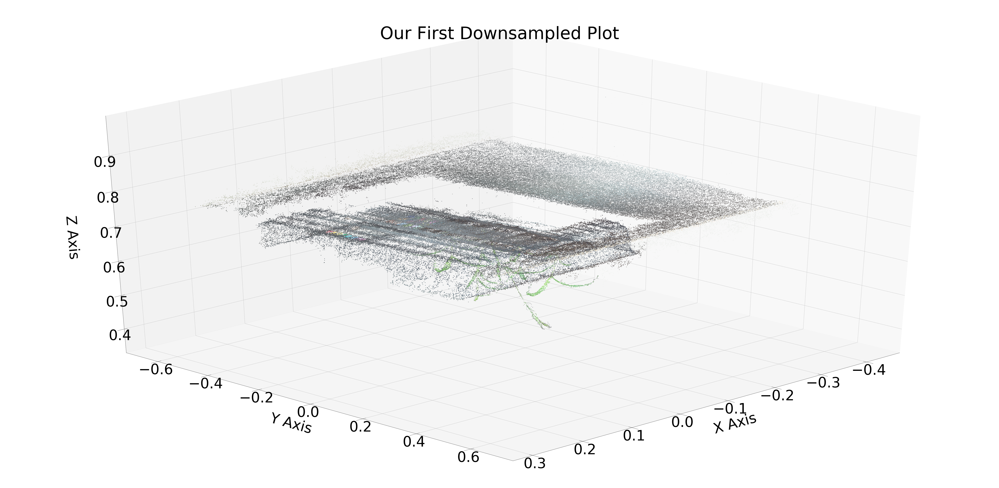

In [26]:
pltParams = u3d.plotParameters()
pltParams.colors = colors[::10]
pltParams.title = 'Our First Downsampled Plot'
u3d.plotLASData(dataset[::10], pltParams)
plt.show()

Notice something is wrong? The lowest values in LiDAR output are often the ones closest to the sensor. 

Thus, the z-axis needs to be flipped for analysis and visualization purposes.

In [27]:
dataset[:,2] = 1-dataset[:,2]

We can also shift the axis from which we view the data.

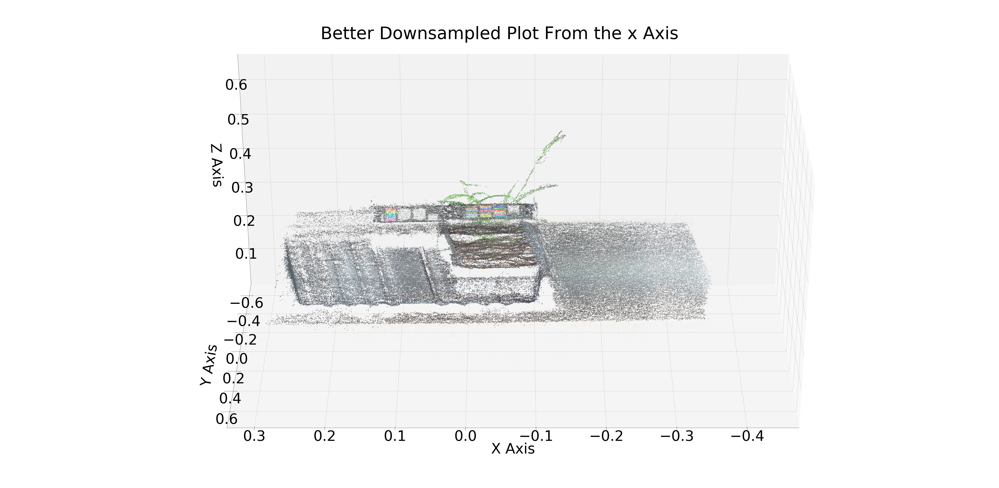

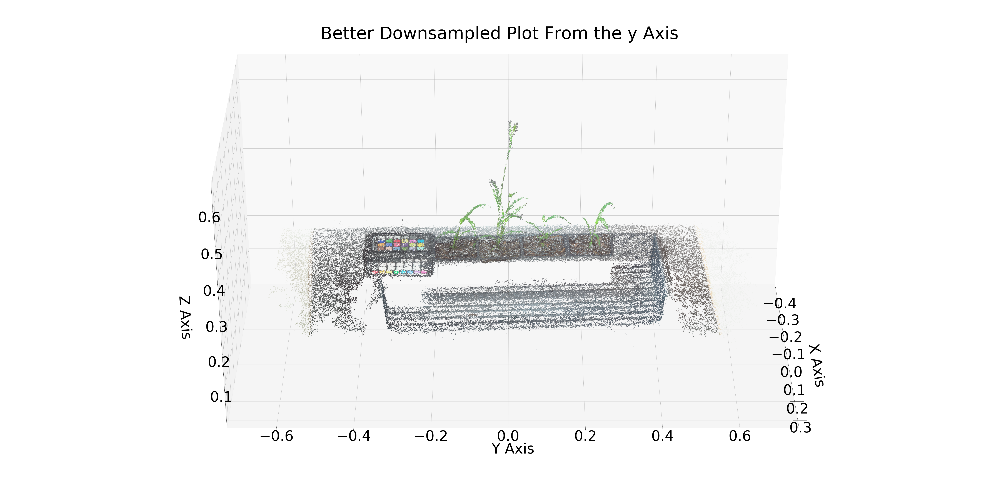

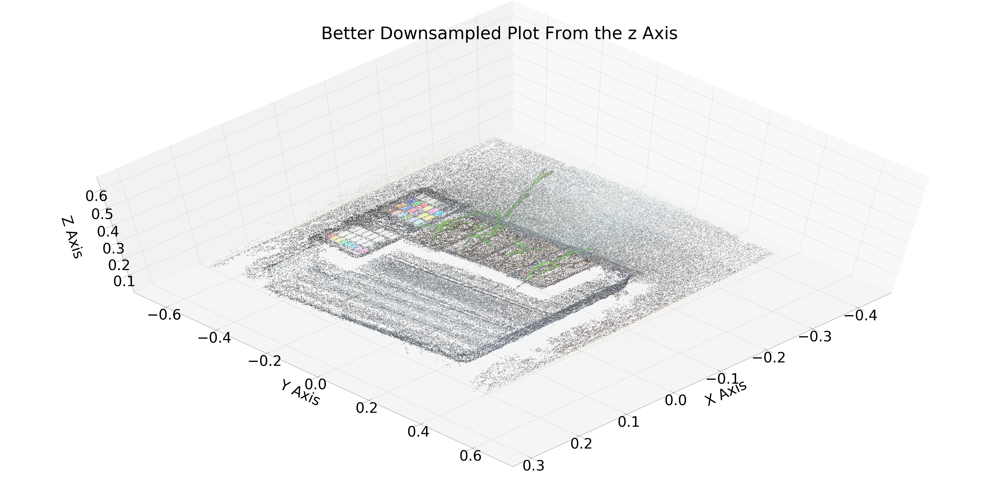

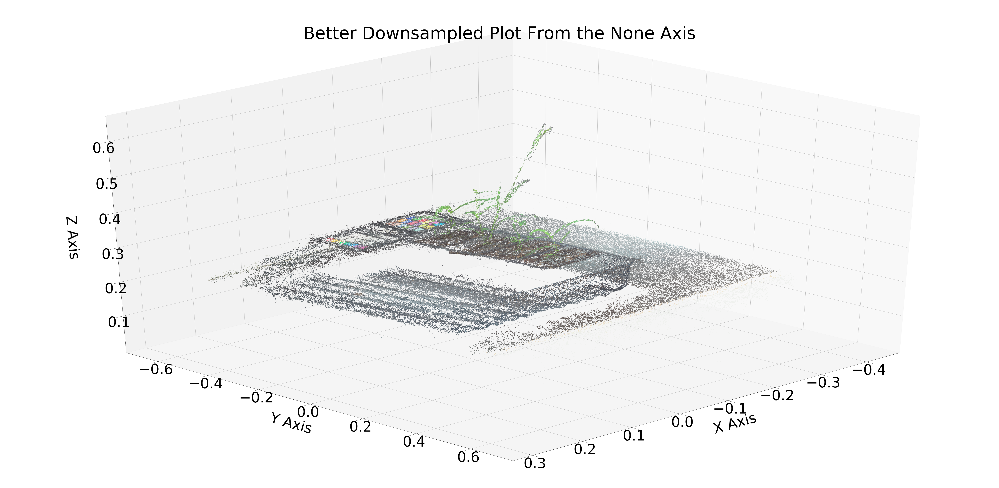

In [31]:
axesViews = ['x', 'y', 'z', None]
for view in axesViews:
    pltParams.axisView = view
    pltParams.colors = colors[::10]
    pltParams.title = f'Better Downsampled Plot From the {view} Axis'
    u3d.plotLASData(dataset[::10], pltParams)
    plt.show()

# Choose our threshold value for background removal
Check out the histogram of the z-axis to make this decision. Also note that this is not the best way to do background extraction due the fact that there will rarely ever be one clean line at which we may remove all the background.

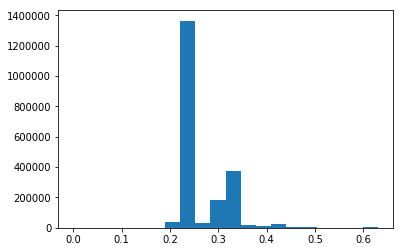

In [32]:
plt.rcParams.update({'font.size': 10})
plt.hist(dataset[:,2], bins=20)
plt.show()

It looks like the plants start somewhere around 0.34, so let's try some values around there and plot them as we go

Indexes of found numbers: [ 116198  117864  647343 ... 2057053 2057807 2058071] 
Percent reduction: 86.22045529336611%


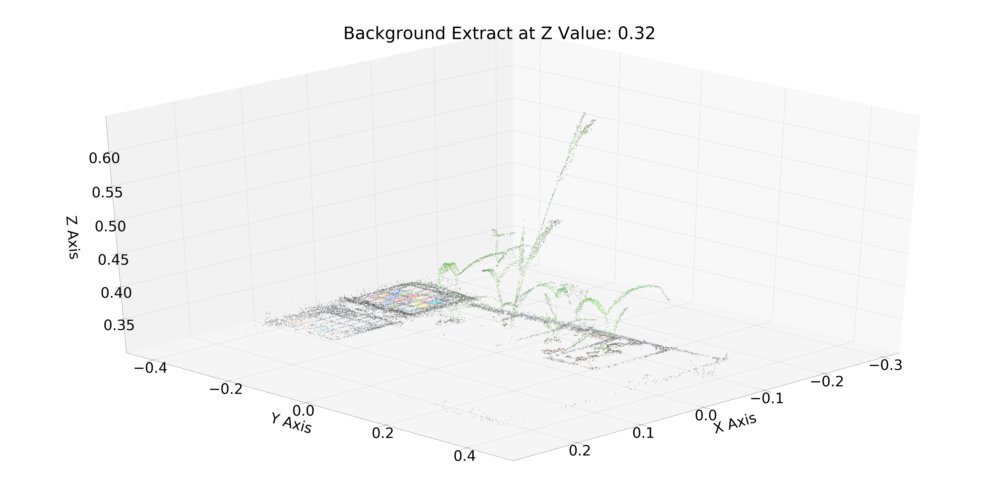

Indexes of found numbers: [ 116198  117864  647343 ... 2017883 2017973 2022333] 
Percent reduction: 96.27533440446001%


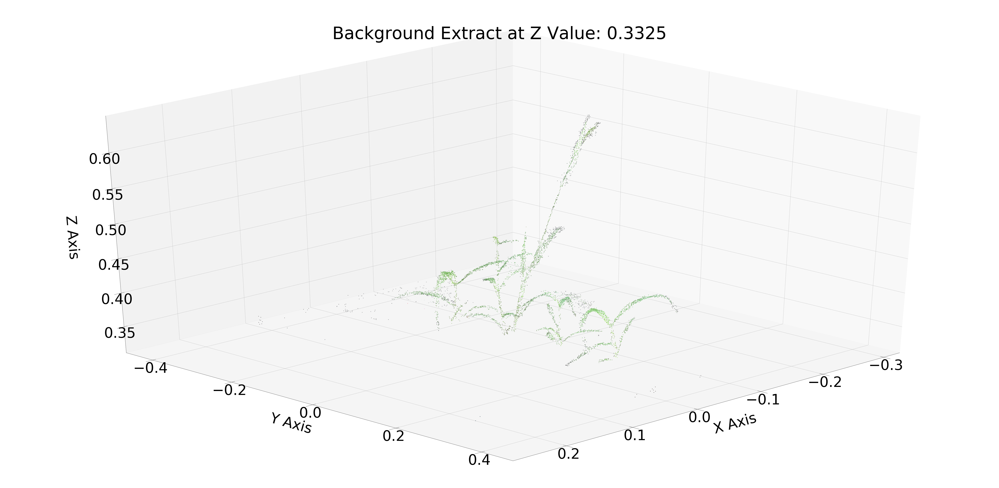

Indexes of found numbers: [ 116198  117864  647343 ... 2010367 2011433 2012314] 
Percent reduction: 96.50346503029482%


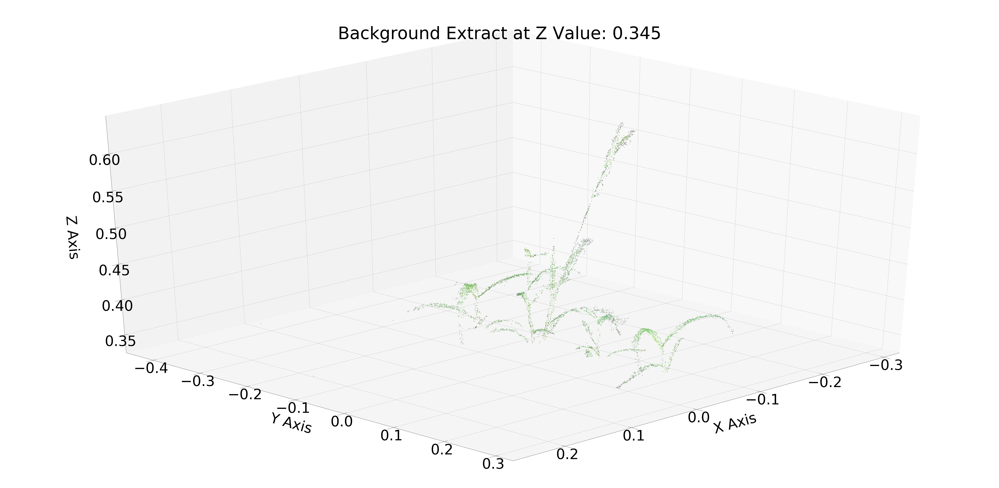

Indexes of found numbers: [ 647343  647892  648118 ... 1459018 1459295 1459738] 
Percent reduction: 96.80554211270059%


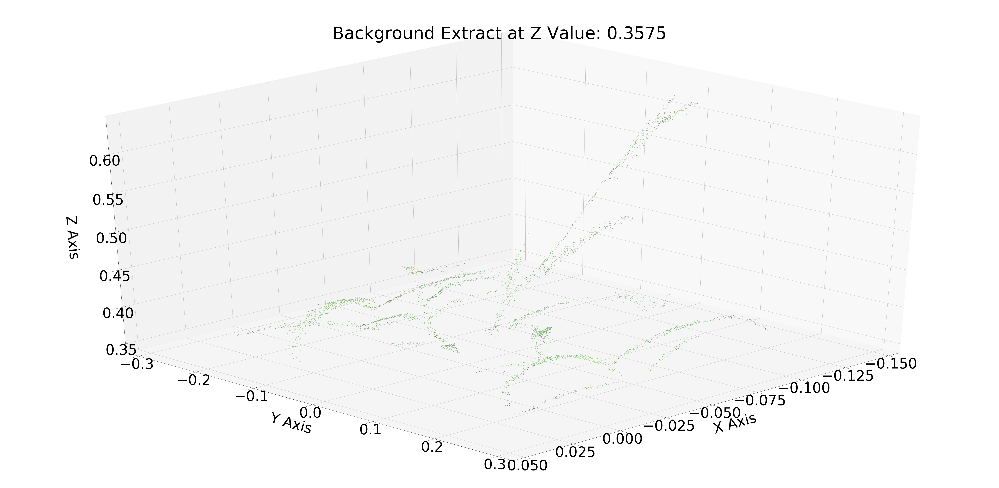

Indexes of found numbers: [ 647343  647892  648118 ... 1459018 1459295 1459738] 
Percent reduction: 97.17822644650496%


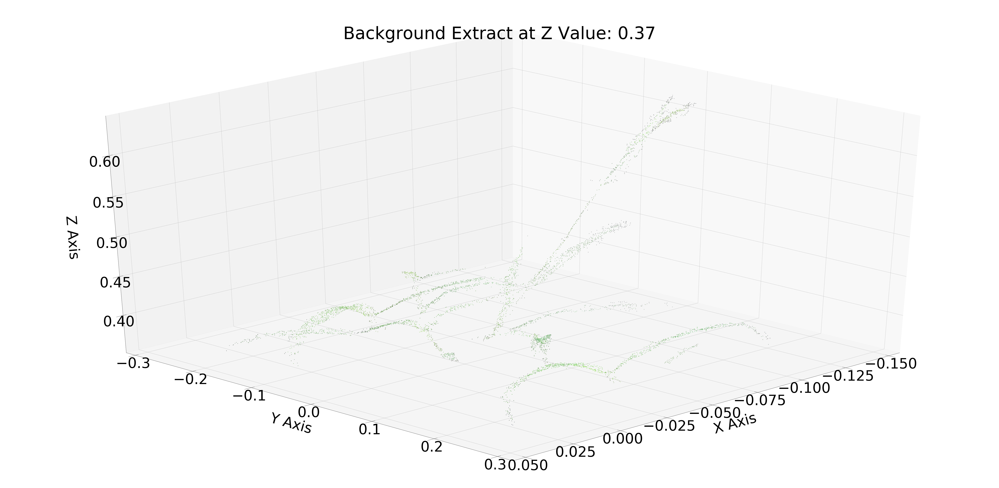

In [33]:
for zval in np.linspace(0.32, 0.37, 5):
    thrDataset, thrCols = u3d.zThresholdBackgroundExtract(dataset, colors, zval)
    pltParams.title = f'Background Extract at Z Value: {zval}'
    pltParams.colors = thrCols[::10]
    # downsample and plot again
    u3d.plotLASData(thrDataset[::10], pltParams)
    plt.show()

# Now extract the background by color

In [ ]:
bgExtractParams = u3d.bgExtractParameters()
hsvBGColors, hsvBGDataset, _ = u3d.extractBGColor3D(dataset, colors, bgExtractParams)

## Plot the color-extracted data


In [ ]:
pltParams.title = f'HSV BG: Hue - {bgExtractParams.hueBounds}, Sat - {bgExtractParams.satLow}, Val - {bgExtractParams.valLow}'
pltParams.colors = hsvBGColors
u3d.plotLASData(hsvBGDataset, pltParams)
plt.show()

Now you see that we still have these color tiles in the image. We can get rid of those by using the function above. It essentially just takes y-axis "windows" of the image and checks their height. If any window has a max value beneath the parameter-set percentile along the z-axis, the whole window is deleted.

The user may change the size of the window and the threshold value in the trimLowDataParams class.

In [ ]:
trimData, trimColors = u3d.trimLowData(hsvBGDataset, hsvBGColors, u3d.trimLowDataParams())
pltParams.title = f'Low-Cut: HSV BG: Hue - {bgExtractParams.hueBounds}, Sat - {bgExtractParams.satLow}, Val - {bgExtractParams.valLow}'
pltParams.colors = trimColors
u3d.plotLASData(trimData, pltParams)

### And now we have a fully background-extracted plant set!

# Gedesic Distance Algorithms
Now we want to look at the lidar data as a graph. Let's use the u3d.Graph class to do some calculations

*Note: These data structures and algorithms are very memory intensive. If you get a "Memory Error" at some point, consider downsampling the data or moving to a computer with a higher amount of RAM. This example works on a computer with 32 GB of RAM.*

Start by isolating the 4th plant. Feel free to plot this to confirm, but we will skip that step here to save time.

In [34]:
tmp = trimData[np.where(trimData[:,1] > 0.18)]
plant4Cols = trimColors[np.where(trimData[:,1] > 0.18)]
plant4Data = tmp

Begin by creating a graph whose edges are defined by an "epsilon" value that determines how close two points must be to create an edge. 0.005 is a good distance for a normalized .las file.

In [35]:
G = u3d.Graph(eps=0.005)

Using the original data and some histogram data, we will find the center of the plant being used as an input for an algorithm we will soon use.

Midpoint(s) established at index 6103


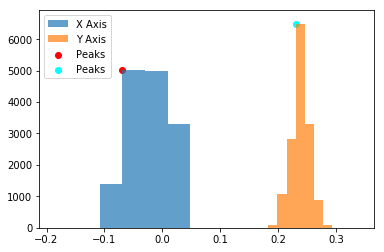

In [36]:
G.findMidPoint(plant4Data)
G.plotMidPointHists(plant4Data)

Note that two internal members now have defined values

In [37]:
G.midPoints, G.midIdx

([-0.03650674848997873, 0.22982398965977224, 0.39072627275611627], 6103)

Now we will connect the points using the epsilon value defined earlier

In [38]:
G.buildFullyConnectedGraph(plant4Data)

FCG is built


Using Dijkstra's algorithm, we may calculate the geodesic distance of each connected point in the fully connected graph from a single point (our mid point determined earlier).

In [39]:
G.Dijkstra()

Once this algorithm completes, there remains a set of valid indexes, and their geodesic distances away from the mid point.

In [40]:
validIndexes = [d for d in G.D.keys()]
geoDistances = [v for v in G.D.values()]
# normalize the distances relative to one another
geoDistances = geoDistances/max(geoDistances)
plant4Valid = plant4Data[validIndexes]

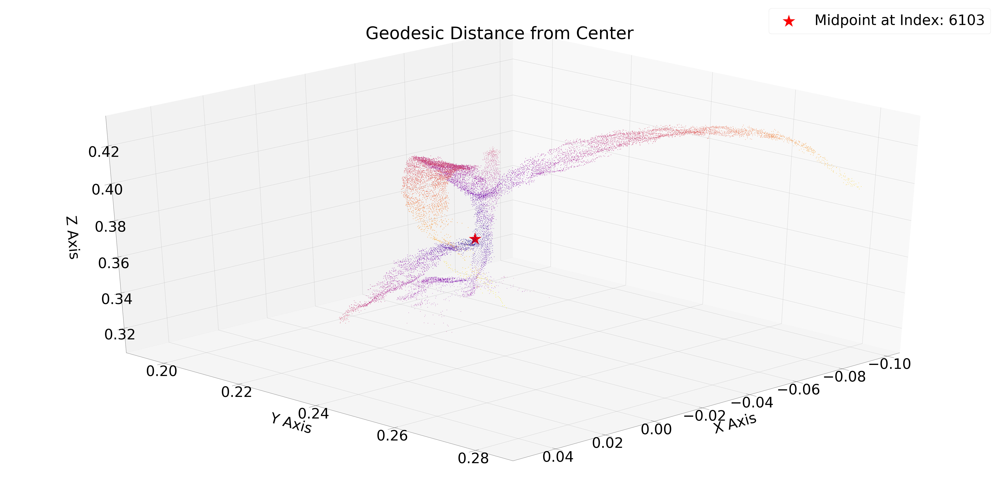

In [41]:
plotParams = u3d.plotParameters()
plotParams.colors = geoDistances
plotParams.cmap = 'plasma'
plotParams.title = 'Geodesic Distance from Center'
fig, ax = u3d.plotLASData(plant4Valid, plotParams)
ax.scatter(plant4Data[G.midIdx,0], plant4Data[G.midIdx,1], plant4Data[G.midIdx,2], s=5000, c='r', marker='*', label=f'Midpoint at Index: {G.midIdx}')
plt.legend()
plt.show()

Here is the colorbar being used above for reference

In [42]:
plt.rcParams.update({'font.size': 15})

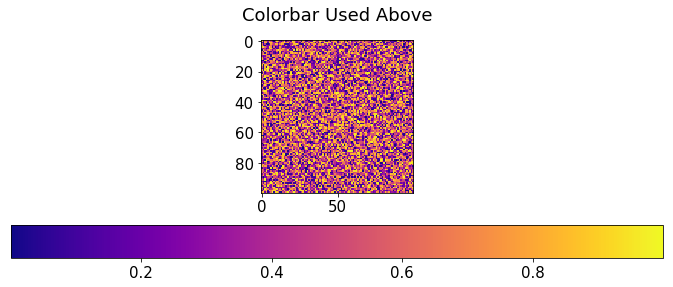

In [43]:
plt.title("Colorbar Used Above", pad=20)
plt.imshow(np.random.random((100,100)), cmap=plotParams.cmap)
plt.colorbar(orientation='horizontal', shrink=3)
plt.show()

Thus we can see that the lightest points in the scatter plot are at the tips of the leaves, which are not necessarily the farthest points away in euclidean distance, but most certainly are in geodesic distance. These methods can be used for segmentation of plants.

# Make a Z-Axis Heat Map
All we are going to do here is view the max and mean heat maps of the z-axis from the top of the plants. This is useful for understanding the distribution of the data as a whole.

Making a heatmap of shape (4500, 6000)


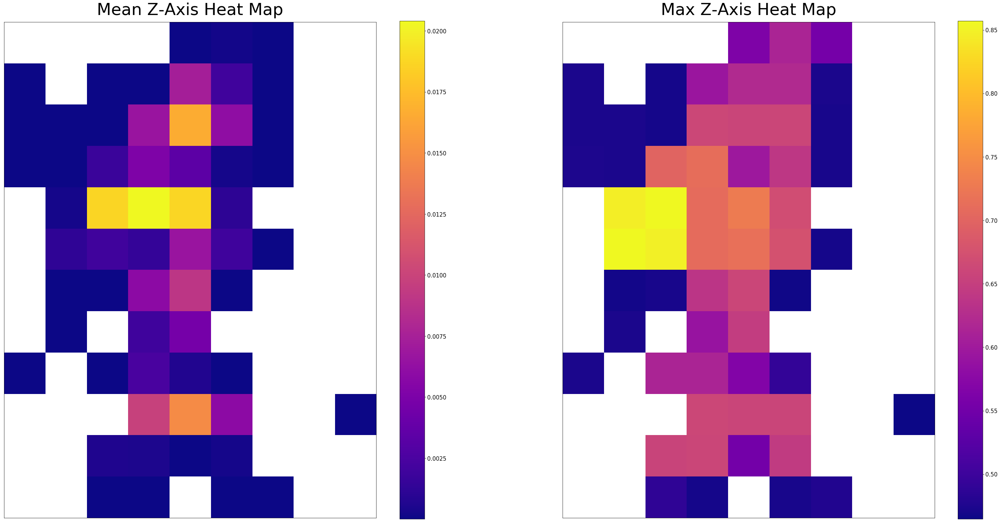

Making a heatmap of shape (4500, 6000)


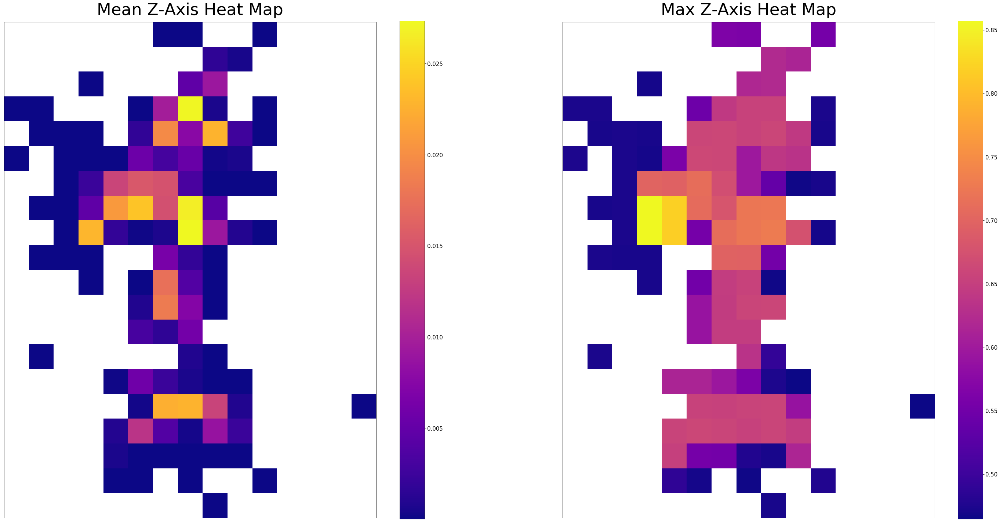

Making a heatmap of shape (4400, 5800)


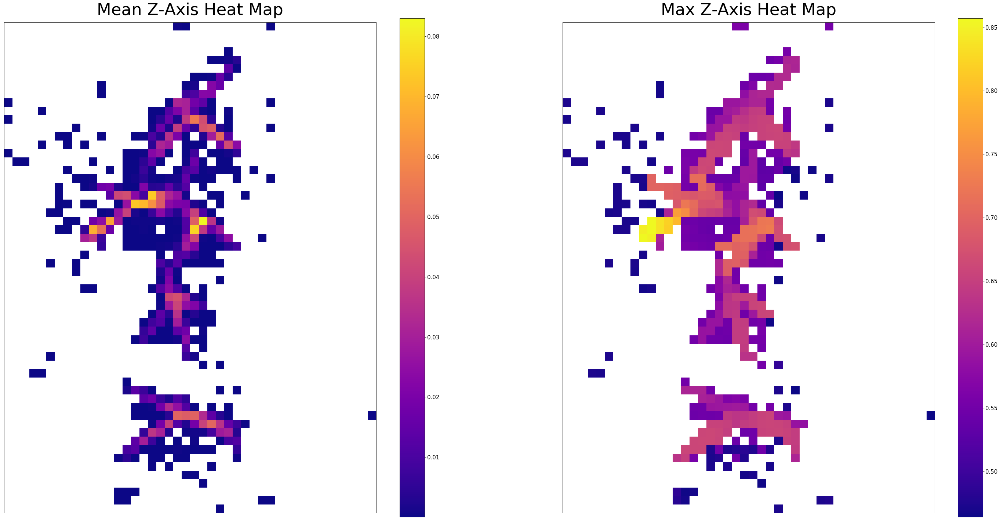

Making a heatmap of shape (4400, 5750)


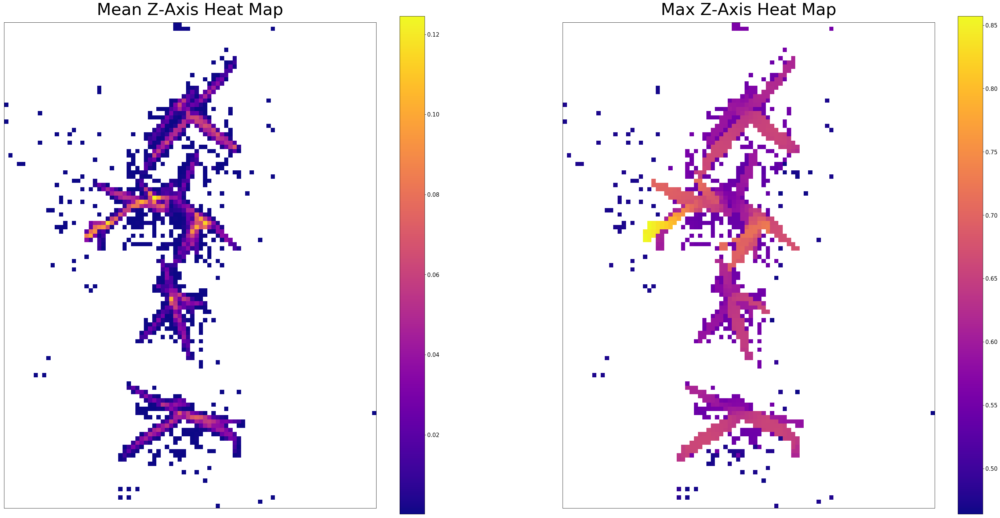

In [44]:
hmParams = u3d.heatMapParams()
blocks = [50, 100, 300, 500]
for b in reversed(blocks):
    hmParams.blockSize = b
    u3d.makeHeatMap(trimData, hmParams)

Note how the granularity of the heat map changes as the size of the blocks change also